In [99]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
import numpy as np

In [100]:
!pwd

/home/walml/repos/zoobot/notebooks


In [101]:
df = pd.read_csv('../data/ring_tag_catalog_all.csv')

In [102]:
rings = df.query('tag_count > 0')

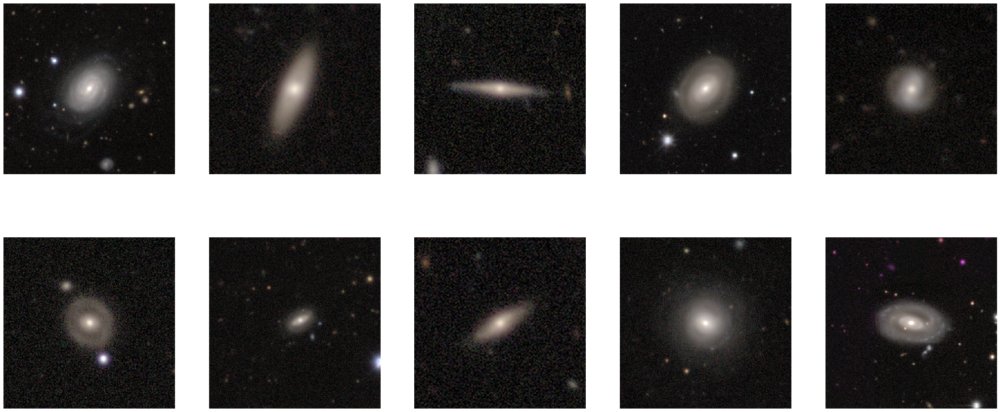

In [103]:
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(36, 16))
all_axes = [ax for row in axes for ax in row]
for n in range(10):
    im = Image.open(rings['local_png_loc'][n])
    all_axes[n].imshow(im)
    all_axes[n].axis(False)

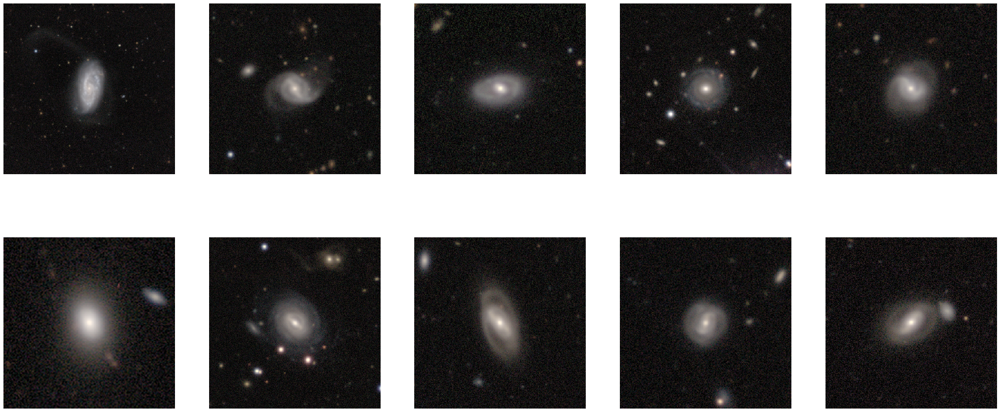

In [104]:
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(36, 16))
all_axes = [ax for row in axes for ax in row]
for n in range(10):
    im = Image.open(rings['local_png_loc'][n+10])
    all_axes[n].imshow(im)
    all_axes[n].axis(False)

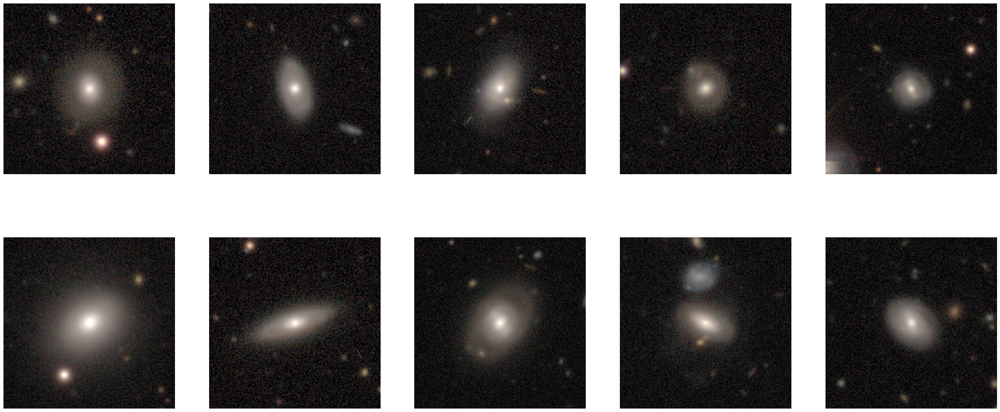

In [105]:
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(36, 16))
all_axes = [ax for row in axes for ax in row]
for n in range(10):
    im = Image.open(rings['local_png_loc'][n+20])
    all_axes[n].imshow(im)
    all_axes[n].axis(False)

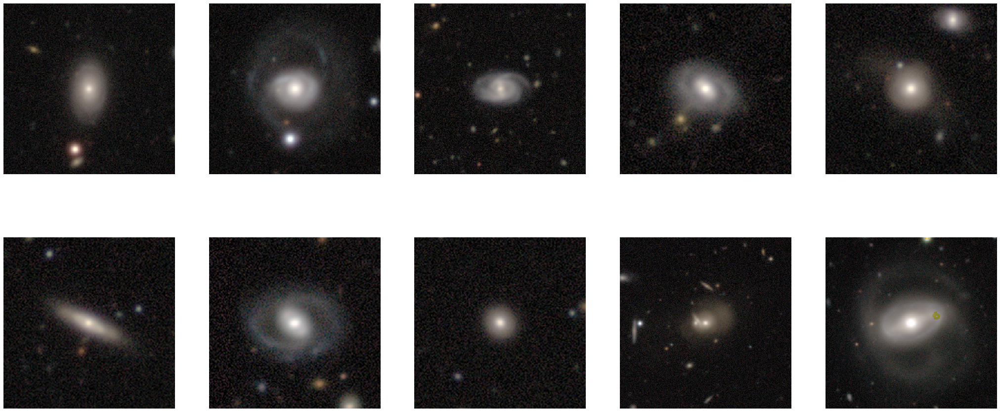

In [106]:
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(36, 16))
all_axes = [ax for row in axes for ax in row]
for n in range(10):
    im = Image.open(rings['local_png_loc'][n+30])
    all_axes[n].imshow(im)
    all_axes[n].axis(False)

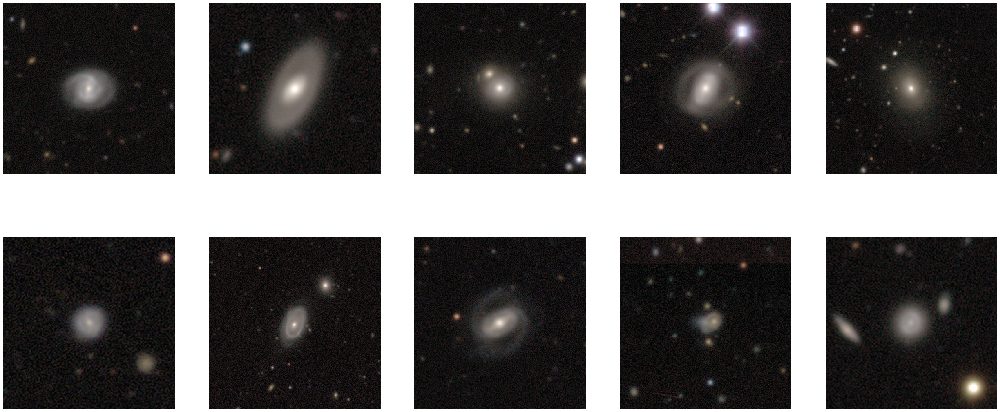

In [107]:
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(36, 16))
all_axes = [ax for row in axes for ax in row]
for n in range(10):
    im = Image.open(rings['local_png_loc'][n+40])
    all_axes[n].imshow(im)
    all_axes[n].axis(False)

In [137]:
morph_cols = [
    'smooth-or-featured_featured-or-disk_fraction',
    'disk-edge-on_no_fraction',
    'has-spiral-arms_no_fraction'
]

In [140]:
preds = pd.read_parquet('/home/walml/repos/zoobot_private/gz_decals_auto_posteriors.parquet', columns=morph_cols+['iauname'])

In [109]:
ring_preds = pd.merge(rings, preds, on='iauname', how='inner')

In [110]:
ring_preds['smooth-or-featured_featured-or-disk_fraction']

0       0.896704
1       0.341311
2       0.768587
3       0.722452
4       0.641906
          ...   
2637    0.605217
2638    0.452941
2639    0.651499
2640    0.888195
2641    0.526259
Name: smooth-or-featured_featured-or-disk_fraction, Length: 2642, dtype: float64

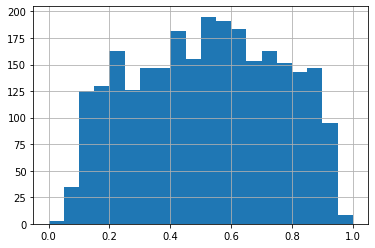

In [111]:
ring_preds['smooth-or-featured_featured-or-disk_fraction'].hist(bins=20, range=(0, 1))

In [134]:
smooth = ring_preds[ring_preds['smooth-or-featured_featured-or-disk_fraction'] < 0.4].reset_index(drop=True)
feat = ring_preds[ring_preds['smooth-or-featured_featured-or-disk_fraction'] > 0.6].reset_index(drop=True)
feat_face = feat[feat['disk-edge-on_no_fraction'] > 0.75].reset_index(drop=True)
not_spiral = feat_face[feat_face['has-spiral-arms_no_fraction'] > 0.5].reset_index(drop=True)

In [136]:
print(len(smooth), len(feat), len(feat_face), len(not_spiral))

876 1043 996 235


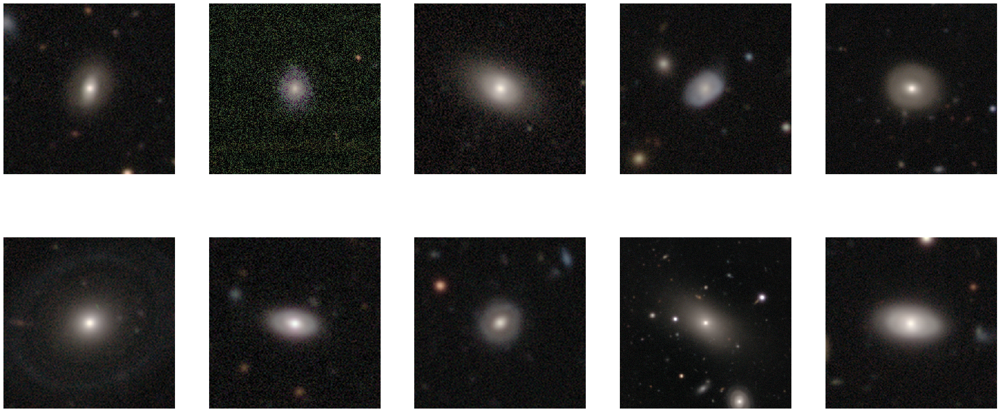

In [113]:
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(36, 16))
all_axes = [ax for row in axes for ax in row]
for n in range(10):
    im = Image.open(smooth['local_png_loc'][n+40])
    all_axes[n].imshow(im)
    all_axes[n].axis(False)

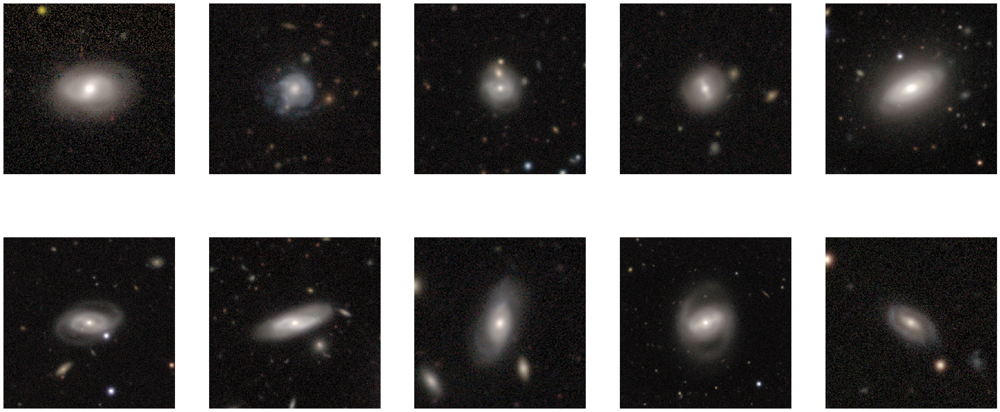

In [114]:
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(36, 16))
all_axes = [ax for row in axes for ax in row]
for n in range(10):
    im = Image.open(feat['local_png_loc'][n+40])
    all_axes[n].imshow(im)
    all_axes[n].axis(False)

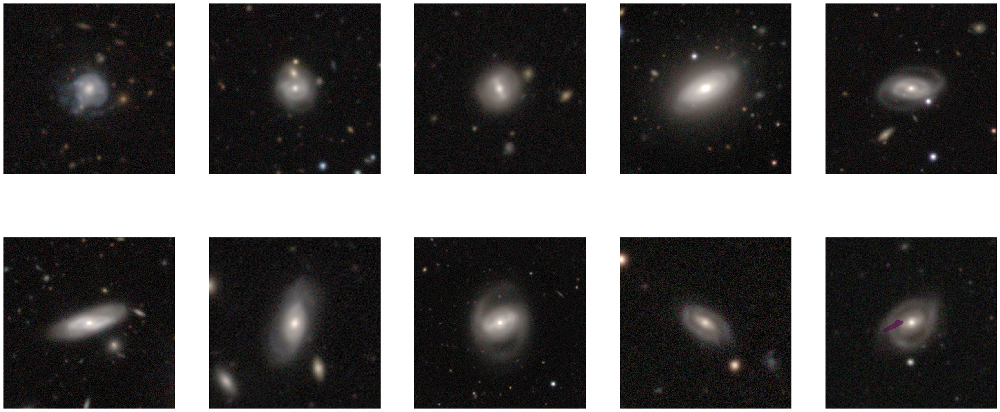

In [115]:
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(36, 16))
all_axes = [ax for row in axes for ax in row]
for n in range(10):
    im = Image.open(feat_face['local_png_loc'][n+40])
    all_axes[n].imshow(im)
    all_axes[n].axis(False)

In [116]:
len(feat_face)

1007

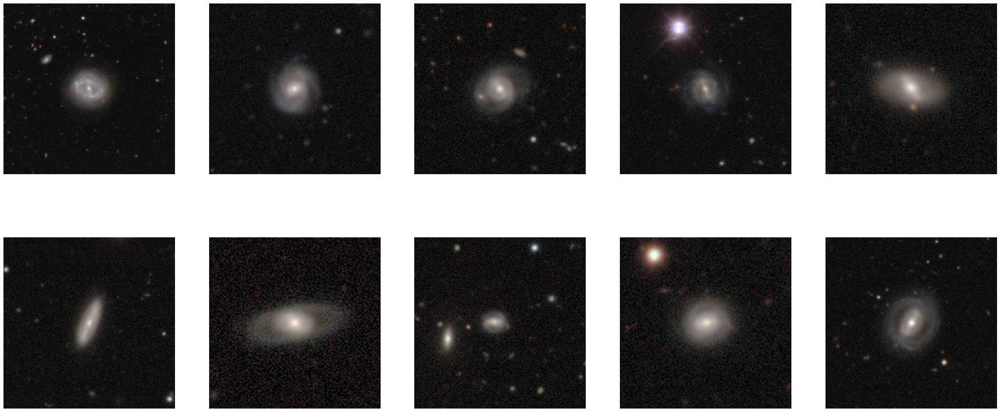

In [117]:
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(36, 16))
all_axes = [ax for row in axes for ax in row]
for n in range(10):
    im = Image.open(feat_face['local_png_loc'][n+100])
    all_axes[n].imshow(im)
    all_axes[n].axis(False)

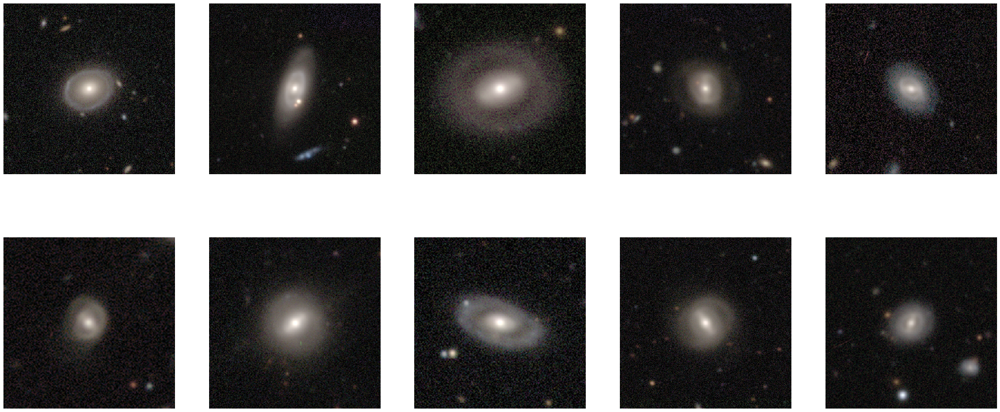

In [135]:
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(36, 16))
all_axes = [ax for row in axes for ax in row]
for n in range(10):
    im = Image.open(not_spiral['local_png_loc'][n+100])
    all_axes[n].imshow(im)
    all_axes[n].axis(False)

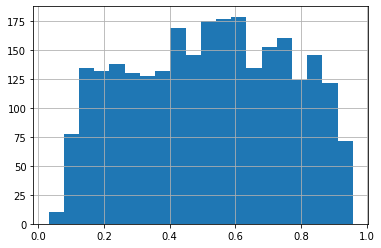

In [127]:
ring_preds['smooth-or-featured_featured-or-disk_fraction'].hist(bins=20)

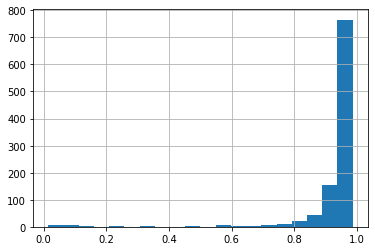

In [125]:
feat['disk-edge-on_no_fraction'].hist(bins=20)

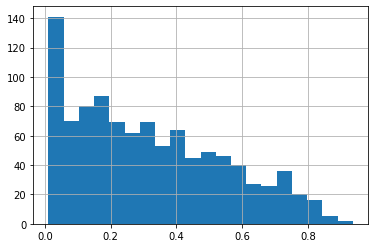

In [129]:
feat_face['has-spiral-arms_no_fraction'].hist(bins=20)

In [119]:
len(not_spiral)

143

In [120]:
not_spiral.iloc[102]

iauname                                                                            J141545.94+102619.8
tag_count                                                                                            1
local_png_loc                                        /media/walml/beta1/decals/png_native/dr5/J141/...
smooth-or-featured_smooth_concentration              [16.9, 18.7129, 21.6262, 19.9226, 20.5558, 28....
smooth-or-featured_featured-or-disk_concentration    [53.5227, 47.2262, 53.2994, 48.47, 55.2235, 52...
                                                                           ...                        
edge-on-bulge_proportion_volunteers_asked                                                    0.0526541
spiral-winding_proportion_volunteers_asked                                                    0.182271
spiral-arm-count_proportion_volunteers_asked                                                  0.182271
merging_proportion_volunteers_asked                                      

In [121]:
not_spiral.iloc[103]

iauname                                                                            J141857.36+002156.1
tag_count                                                                                            1
local_png_loc                                        /media/walml/beta1/decals/png_native/dr5/J141/...
smooth-or-featured_smooth_concentration              [30.7865, 30.4856, 27.8025, 32.5492, 39.2576, ...
smooth-or-featured_featured-or-disk_concentration    [49.1435, 40.2586, 51.2672, 43.1614, 53.7604, ...
                                                                           ...                        
edge-on-bulge_proportion_volunteers_asked                                                    0.0198452
spiral-winding_proportion_volunteers_asked                                                    0.201977
spiral-arm-count_proportion_volunteers_asked                                                  0.201977
merging_proportion_volunteers_asked                                      

In [122]:
not_spiral.iloc[102]['local_png_loc'], not_spiral.iloc[103]['local_png_loc']

('/media/walml/beta1/decals/png_native/dr5/J141/J141545.94+102619.8.png',
 '/media/walml/beta1/decals/png_native/dr5/J141/J141857.36+002156.1.png')

In [141]:
ring_catalog_with_morph = pd.merge(df, preds, how='inner', on='iauname')

In [145]:
ring_catalog_with_morph['ring'] = (ring_catalog_with_morph['tag_count'] > 0).astype(int)

In [146]:
ring_catalog_with_morph

,iauname,tag_count,local_png_loc,smooth-or-featured_featured-or-disk_fraction,disk-edge-on_no_fraction,has-spiral-arms_no_fraction,ring
0,J000035.60-014547.0,1.0,/media/walml/beta1/decals/png_native/dr5/J000/...,0.896704,0.969745,0.032284,1
1,J000039.31-000048.2,1.0,/media/walml/beta1/decals/png_native/dr5/J000/...,0.341311,0.587562,0.878487,1
2,J000127.32+141126.9,1.0,/media/walml/beta1/decals/png_native/dr5/J000/...,0.768587,0.017421,0.780782,1
3,J000221.59+040522.9,1.0,/media/walml/beta1/decals/png_native/dr5/J000/...,0.722452,0.955182,0.354890,1
4,J000251.60+000800.7,1.0,/media/walml/beta1/decals/png_native/dr5/J000/...,0.641906,0.974764,0.285697,1
...,...,...,...,...,...,...,...
253281,J144017.17+234347.3,0.0,/media/walml/beta1/decals/png_native/dr5/J144/...,0.081090,0.936089,0.968052,0
253282,J133751.46+253954.0,0.0,/media/walml/beta1/decals/png_native/dr5/J133/...,0.188672,0.389236,0.912858,0
253283,J130734.26+061155.7,0.0,/media/walml/beta1/decals/png_native/dr5/J130/...,0.097921,0.926792,0.965271,0
253284,J163830.70+315116.7,0.0,/media/walml/beta1/decals/png_native/dr5/J163/...,0.095984,0.726577,0.676130,0


In [147]:
ring_catalog_with_morph.to_csv('../data/ring_catalog_with_morph.csv', index=False)